In [2]:
import cv2
import numpy as np
import PIL
import os
import matplotlib.pyplot as plt
import matplotlib as mpl
from scipy import ndimage as ndi
from skimage.feature import peak_local_max
from skimage.segmentation import watershed
from networkx.algorithms.bipartite import hopcroft_karp_matching, to_vertex_cover, minimum_weight_full_matching
from networkx.algorithms.approximation import min_maximal_matching, min_weighted_vertex_cover
import networkx as nx

In [3]:
IMAGE_DIR = "MI01"
MASKS_DIR = f"{IMAGE_DIR}/Masks"
IMAGES_DIR = f"{IMAGE_DIR}/Images"

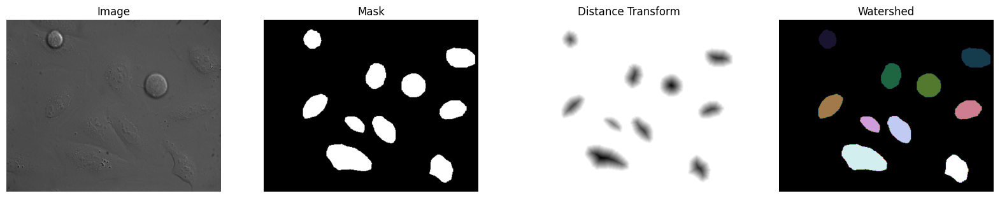

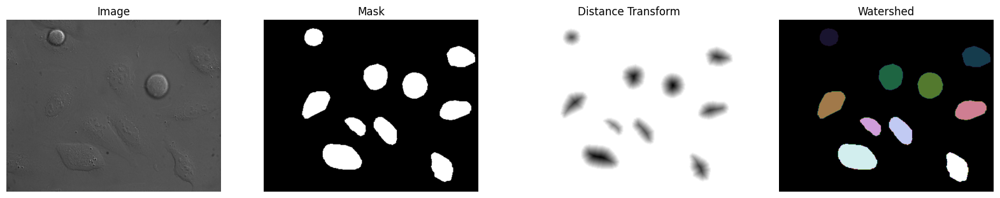

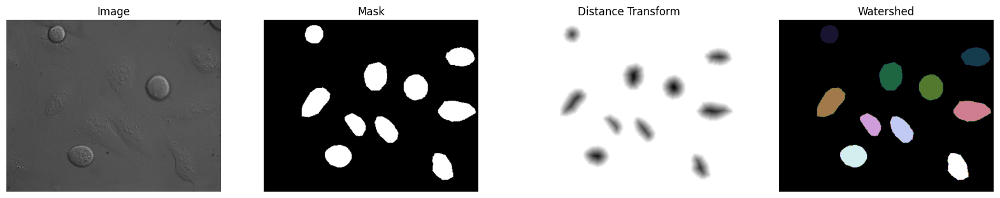

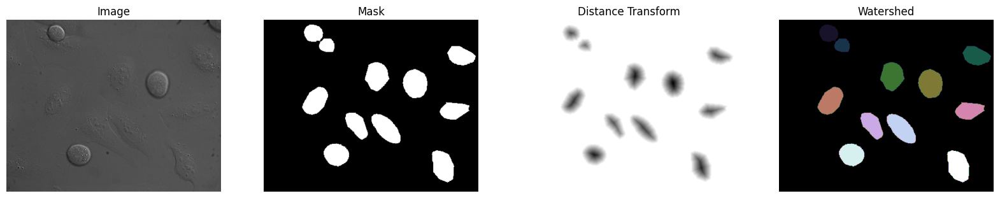

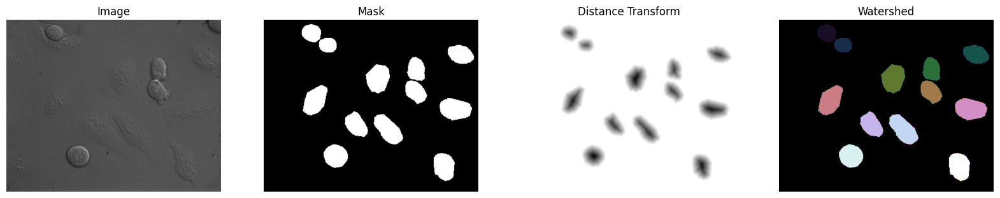

...

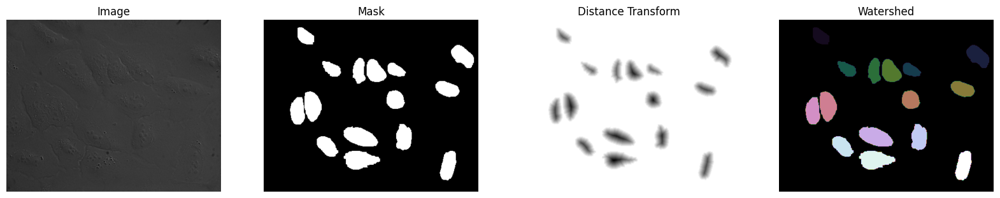

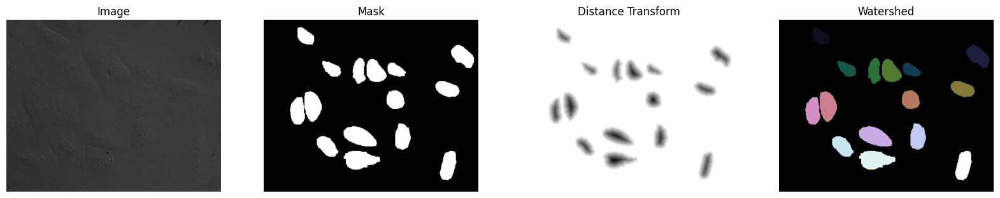

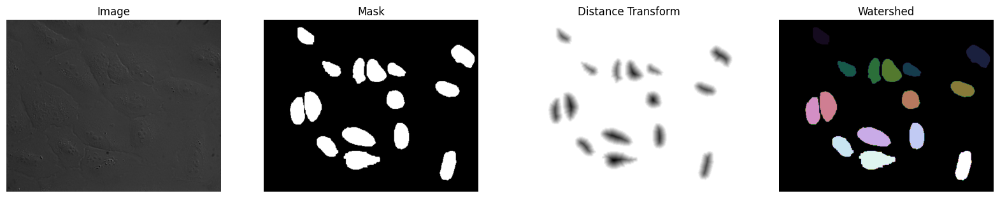

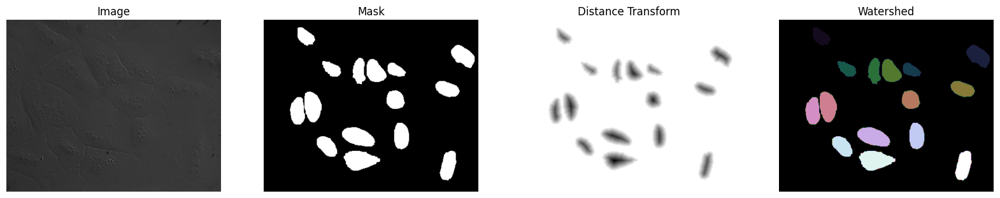

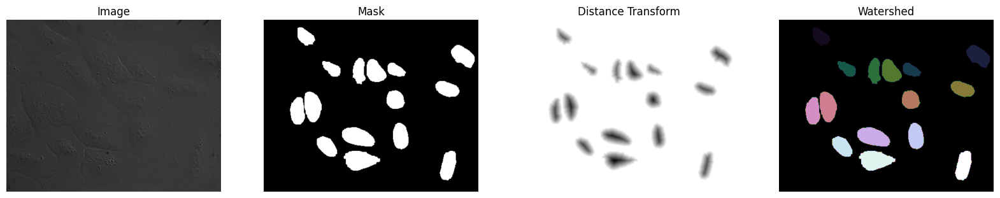

In [26]:
watershed_video_labels = []
watershed_video_markers = []

images = []
for img in os.listdir(MASKS_DIR):
    
    image = cv2.imread(f"{IMAGES_DIR}/I{img[1:]}")
    images.append(image)
    mask_img = cv2.imread(f"{MASKS_DIR}/{img}")
    mask_img = cv2.cvtColor(mask_img, cv2.COLOR_BGR2GRAY)
    ret, thresh = cv2.threshold(mask_img,0,1,cv2.THRESH_BINARY)
    mask = np.array(thresh, dtype=bool)
    
    distance_transform = ndi.distance_transform_edt(mask)
    coords = peak_local_max(distance_transform, min_distance=40)
    watershed_mask = np.zeros(distance_transform.shape, dtype=bool)
    watershed_mask[tuple(coords.T)] = True
    markers, _ = ndi.label(watershed_mask)
    
    watershed_labels = watershed(-distance_transform, markers, mask=mask, watershed_line=False)
    
    watershed_video_labels.append(watershed_labels)
    watershed_video_markers.append(markers)
    # watershed_labels = watershed_labels.squeeze()
    
    fig, ax = plt.subplots(1, 4, figsize=(20,15))
    ax[0].imshow(image, cmap='grey')
    ax[0].set_title("Image")
    ax[0].axis('off')
    ax[1].imshow(mask, cmap='grey')
    ax[1].set_title("Mask")
    ax[1].axis('off')
    ax[2].imshow(-distance_transform, cmap=plt.cm.gray)
    ax[2].set_title("Distance Transform")
    ax[2].axis('off')
    ax[3].imshow(watershed_labels, cmap=plt.cm.cubehelix)
    ax[3].set_title("Watershed")
    ax[3].axis('off')
    
    plt.show()

In [143]:
def check_rows(cm, rows, cols):
    leave_out_index = -1
    n_zeroes = 0
    for i in range(len(cm)):
        if rows[i]:
            continue
        row = cm[i, ~cols]
        num_zero = len(np.where(row == 0)[0])
        if num_zero > n_zeroes:
            n_zeroes = num_zero
            leave_out_index = i
    return leave_out_index, n_zeroes

def check_cols(cm, rows, cols):
    leave_out_index = -1
    n_zeroes = 0
    for j in range(len(cm[0])):
        if cols[j]:
            continue
        col = cm[~rows, j]
        num_zero = len(np.where(col == 0)[0])
        if num_zero > n_zeroes:
            n_zeroes = num_zero
            leave_out_index = j
    return leave_out_index, n_zeroes

# convert_cost_matrix takes as input an initial cost matrix (can be square or non-square)
# then subtracts the minimum of each row from each value in that row
# then from the new array, subtracts the minimum of each column for each value in that column
def convert_cost_matrix(cm):
    cm = np.array(cm)
    cm = cm - np.min(cm, axis=1)[:, None]
    cm = cm - np.min(cm, axis=0)
    return cm

# construct_bipartite_graph takes in a cost matrix and outputs a graph of 
def construct_bipartite_graph(cm):
    graph = np.zeros((cm.shape[0] + cm.shape[1], cm.shape[0] + cm.shape[1]))
    for i in range(len(cm)):
        for j in range(len(cm[i])):
            if cm[i,j] == 0:
                graph[i,j + cm.shape[0]] = 1
                graph[j + cm.shape[0], i] = 1
    # graph = np.pad(graph, [(0,1), (0,1)], mode="constant")            
    return graph


    
def assign_values(cm, rows, cols, assignments, n_assignments):
    
    if n_assignments == cm.shape[0]:
        return assignments
    min_n_zeros = np.inf
    state = ""
    index = -1
    for i in range(len(cm)):
        if rows[i]:
            continue
        row = cm[i, ~cols]
        n_zeros = len(row) - np.count_nonzero(row)
        if n_zeros < min_n_zeros:
            min_n_zeros = n_zeros
            index = i
            state = "row"
    for j in range(len(cm[0])):
        if cols[j]:
            continue
        col = cm[~rows,j]
        n_zeros = len(col) - np.count_nonzero(col)
        if n_zeros < min_n_zeros:
            min_n_zeros = n_zeros
            index = j
            state = "col"
    
    
    if state == "row":
        row_index = index
        col_index = -1
        for ind, val in enumerate(cm[row_index]):
            if val == 0:
                if cols[ind]:
                    continue
                else:
                    col_index = ind
                    # break
        rows[row_index] = True
        cols[col_index] = True
        assignments.append((row_index+1, col_index+1))
    elif state == "col":
        col_index = index
        row_index = -1
        for ind, val in enumerate(cm[:, col_index]):
            if val == 0:
                if rows[ind]:
                    continue
                else:
                    row_index = ind
                    # break
        rows[row_index] = True
        cols[col_index] = True
        assignments.append((row_index+1, col_index+1))
    
    return assign_values(cm, rows, cols, assignments, n_assignments + 1)
    
    
# follow the steps of the hungarian algorithm to solve the maximum bipartite matching using the associated cost matrix cm

# Step 1 - Convert the cost matrix by subtracting each row by the minimum of that row, then each column byh the minimum of that column
# Step 2 - Find the minimum horizontal and vertical lines needed to cover all zeros in the converted cost matrix 
    # a) first construct a bipartite graph with one set of edges being each row label, and the other set of edges being each column label
    # b) second use the hopcroft-karp algorithm to find the matching with maximal number of edges
    # c) third convert the maximal matching obtained from hopcroft karp to a vertex cover, which will be the minimum number of vertices required such that each edge contains an endpoint at one of the vertices
        # the above step is important because the vertex cover of this graph represents the row and column labels that are used as lines to cover all of the zeros present in the converted cost matrix
    # if the length of the vertex cover is equal to the rank of the cost matrix, end here, we can then skip to step 4, otherwise continue to step 3
# Step 3 - make a submatrix of the cost matrix
    # a) submatrix consist of rows and columns now found in vertex cover
    # b) subtract the minimum of matrix 2 from all values of 2 matrix 2
    # c) add the minimum of matrix 2 to the points where the rows and columns from the vertex cover intersect
    # d) update the cost matrix values with the new submatrix values (same location as original submatrix)
    # e) go back to step 2 with a newly updated cost matrix
# Step 4 - assign rows to columns

def hungarian_method(cm):
    # cm =  np.array([[90, 75, 75, 80],
    #                 [35, 85, 55, 65],
    #                 [125, 95, 90, 105],
    #                 [45, 110, 95, 115]])

    cm = convert_cost_matrix(cm)
    i = 0
    while True:
        rows = np.zeros(cm.shape[0], dtype=bool)
        cols = np.zeros(cm.shape[1], dtype=bool)

        graph = construct_bipartite_graph(cm)
        G = nx.from_numpy_array(graph)
        for i, node in enumerate(G.nodes):
            if i < cm.shape[0]:
                G.nodes[i]['bipartite'] = 0
            else:
                G.nodes[i]['bipartite'] = 1
            
        u = [n for n in G.nodes if G.nodes[n]['bipartite'] == 0]
        max_matching = hopcroft_karp_matching(G, top_nodes=u)
        vertex_cover = to_vertex_cover(G, max_matching, top_nodes=u)
        # print(f"Iteration {i}")
        # print("Cost matrix:\n", cm)
        # print("Bipartite graph:\n", graph)
        # print("Maximal matching:", max_matching)
        # print("Vertex Cover:", vertex_cover)
        # plt.figure()
        # nx.draw(G, with_labels=True, pos=nx.bipartite_layout(G, nx.bipartite.sets(G)[0]))
        # plt.show()
        i += 1
        for vertex in vertex_cover:
            if vertex < cm.shape[0]:
                rows[vertex] = True
            else:
                cols[vertex - cm.shape[0]] = True
    
        


        leftover = cm[~rows, :][:,~cols]
        # print(leftover)
        
        n_lines = len(vertex_cover)
        # print("line #:", n_lines)
        # print("cm shape 0:", cm.shape[0])
        # print("cm shape 1:", cm.shape[1])
        # print("vertex cover:", vertex_cover)
        
        if n_lines == cm.shape[0] or n_lines == cm.shape[1] or len(leftover) == 0:
            break
        min_leftover = np.min(leftover)
        
        


        # subtract the minimum of the leftover subset from the leftover subset
        # add the minimum of the leftover subset to the line intersection points
        for i in range(len(rows)):
            for j in range(len(cols)):
                if not rows[i]:
                    if not cols[j]:
                        cm[i,j] -= min_leftover
                if rows[i]:
                    if cols[j]:
                        cm[i,j] += min_leftover

    rows = np.zeros(cm.shape[0], dtype=bool)
    cols = np.zeros(cm.shape[1], dtype=bool)
    assignments = assign_values(cm, rows, cols, [], 0)
    
    
    return cm, assignments

In [144]:
def calculate_distance(x1, y1, x2, y2):
    return np.sqrt((x2 - x1)**2 + (y2 - y1)**2)


def calculate_cost_matrix(frame1, frame2):
    unique_markers1 = np.unique(frame1)
    unique_markers2 = np.unique(frame2)
    
    cm = np.zeros((len(unique_markers1)-1, len(unique_markers2)-1))
    for i in range(len(cm)):
        for j in range(len(cm[i])):
    
            marker_coords1 = np.where(frame1 == i + 1)
            marker_coords2 = np.where(frame2 == j + 1)
            
            # print(marker_coords1)
            # print(marker_coords2)
            # print()
            x1, y1 = marker_coords1[0], marker_coords1[1]
            x2, y2 = marker_coords2[0], marker_coords2[1]
            
            cm[i-1,j-1] = calculate_distance(x1, y1, x2, y2)
    return cm
        
    
    

In [145]:

frame_assignments = []
for i, markers in enumerate(watershed_video_markers):
    if i == 0:
        continue
    
    print(f"Tracking between frames {i - 1} and {i}")
    
    cm = calculate_cost_matrix(watershed_video_markers[i-1], watershed_video_markers[i])
    
    if i == 12:
        print(cm)
    cm, assignments = hungarian_method(cm)
    print(cm)
    for assignment in assignments:
        if assignment[0] == 0 or assignment[1] == 0:
            assignments.remove(assignment)
    
    if i == 12:
        print(assignments)
    frame_assignments.append(assignments)
    # break
    

    print()
    

Tracking between frames 0 and 1


/tmp/ipykernel_7207/2587174705.py:22: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cm[i-1,j-1] = calculate_distance(x1, y1, x2, y2)


[[   0.          498.03654683  298.49442543  876.26347409  306.24332604
   724.19247935  604.6122072   899.68330132  650.96733188  863.65902798]
 [ 504.47691091    0.          233.17665428  369.13953305  489.14699337
   296.52419414  329.64430356  502.61384786  658.95390865  430.80959386]
 [ 309.54518066  221.10807903    0.          573.75317336  264.83555506
   407.94653585  311.12920215  589.60335751  508.6504232   649.21638318]
 [ 881.95944382  377.8793959   586.04657049    0.          796.84631874
   249.45570485  447.15232915  336.6577569   825.89846428  386.37824585]
 [ 304.73203559  492.48880111  258.17698669  804.13367392    0.
   580.62992855  403.26875167  707.56827437  343.13591405  925.73291151]
 [ 729.13402541  303.99017941  417.39277133  261.95796745  575.49769085
     0.          195.41032951  206.11038944  571.98688254  571.13623785]
 [ 594.66770979  302.04837274  295.60930716  418.05820852  390.82019083
   158.31929092    0.          277.3822163   381.87692623  675.935

In [154]:
def find_unique_markers(frame_assignments):
    unique_assignments = set()
    unique_markers = set()
    for assignments in frame_assignments:
        for assignment in assignments:
            unique_assignments.add(assignment)
    for assignment in unique_assignments:
        unique_markers.add(assignment[0])
        unique_markers.add(assignment[1])
    # unique_markers.remove(0)
    return unique_markers

### Generate tracks using marker assignments from hungarian method and computed watershed marker locations

In [297]:
np.where(watershed_video_markers[3] ==2)

(array([151]), array([378]))

In [294]:
markers = find_unique_markers(frame_assignments)

tracks = {}
frame_found = {}
prev_markers = {}
for marker in markers:
    if marker not in prev_markers.keys():
        prev_markers[marker] = [marker]
        frame_found[marker] = []
    i = 0
    while i != len(frame_assignments):
        assignment_list = frame_assignments[i]
        for assignment in assignment_list:
            # if assignment[0] == 0 or assignment[1] == 0:
            #     assignment_list.remove(assignment)
            if assignment[0] == prev_markers[marker][-1]:
                prev_markers[marker].append(assignment[1])
                frame_found[marker].append(i)
                break
        i += 1
        
    for j in range(0, len(frame_found[marker])-1):
        label1, label2 = prev_markers[marker][j], prev_markers[marker][j+1]
        frame1, frame2 = frame_found[marker][j], frame_found[marker][j+1]
        
        loc1 = np.where(watershed_video_markers[frame1] == label1)
        loc2 = np.where(watershed_video_markers[frame2] == label2)
        if marker == 2:
            print(prev_markers[marker])
            print(frame_found[marker])
            
            print(f"{label1} to {label2}")
            print(f"{frame1} to {frame2}")
            print(loc1)
            print(loc2)
            print()
        loc1 = tuple([x[0] for x in loc1])
        loc2 = tuple([x[0] for x in loc2])
        
        if marker not in tracks.keys():
            tracks[marker] = [loc1]
        
        tracks[marker].append(loc2)
        
        if j == len(prev_markers[marker]) - 1:
            break




[2, 2, 2, 3, 4, 4, 4, 4, 4, 4, 4, 3, 5, 4, 3, 4, 4, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 4, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 5, 4, 5, 4, 4, 5, 3, 4, 4, 4, 4, 4, 4, 4]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67]
2 to 2
0 to 1
(array([227]), array([1161]))
(array([219]), array([1162]))

[2, 2, 2, 3, 4, 4, 4, 4, 4, 4, 4, 3, 5, 4, 3, 4, 4, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 4, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 5, 4, 5, 4, 4, 5, 3, 4, 4, 4, 4, 4, 4, 4]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63,

In [305]:
np.where(watershed_video_markers[3] ==4)

(array([336]), array([676]))

In [303]:
print(prev_markers[2])
for i in range(len(prev_markers[2])-1):
    marker1 = prev_markers[2][i]
    marker2 = prev_markers[2][i+1]
    loc1 = np.where(watershed_video_markers[i] == marker1)
    loc2 = np.where(watershed_video_markers[i + 1] == marker2)
    print(loc1, loc2)

[2, 2, 2, 3, 4, 4, 4, 4, 4, 4, 4, 3, 5, 4, 3, 4, 4, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 4, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 5, 4, 5, 4, 4, 5, 3, 4, 4, 4, 4, 4, 4, 4]
(array([227]), array([1161])) (array([219]), array([1162]))
(array([219]), array([1162])) (array([220]), array([1175]))
(array([220]), array([1175])) (array([211]), array([1157]))
(array([211]), array([1157])) (array([295]), array([910]))
(array([295]), array([910])) (array([320]), array([918]))
(array([320]), array([918])) (array([301]), array([909]))
(array([301]), array([909])) (array([311]), array([923]))
(array([311]), array([923])) (array([311]), array([910]))
(array([311]), array([910])) (array([293]), array([922]))
(array([293]), array([922])) (array([269]), array([922]))
(array([269]), array([922])) (array([289]), array([907]))
(array([289]), array([907])) (array([295]), array([915]))
(array([295]), array([915])) (array([204]), array([1202]))
(array([204]), array([1202])) 

In [231]:
indices = np.where(watershed_video_labels[0] == 5)
print(indices)
print(np.mean(indices[0]), np.mean(indices[1]))
cubehelix = mpl.colormaps['cubehelix'].resampled(16)
rgba = cubehelix(5)
rgba = [255 * val for val in rgba]
print(rgba)

(array([442, 442, 442, ..., 588, 588, 588]), array([336, 337, 338, ..., 259, 260, 261]))
513.8292566274938 304.34264826455313
[43.3607919086978, 111.38338710116908, 57.05001666666665, 255.0]


In [232]:
cubehelix = mpl.colormaps['cubehelix'].resampled(len(tracks))

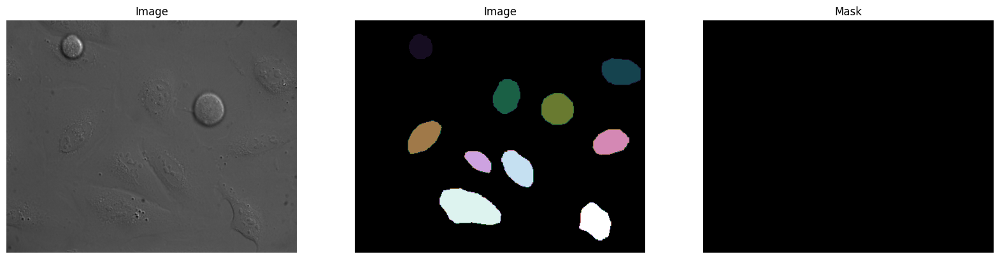

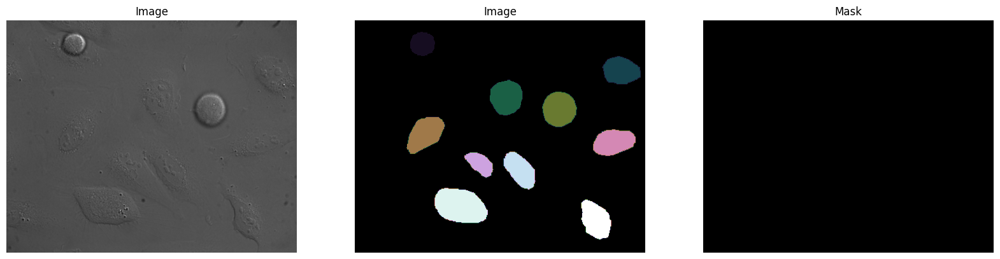

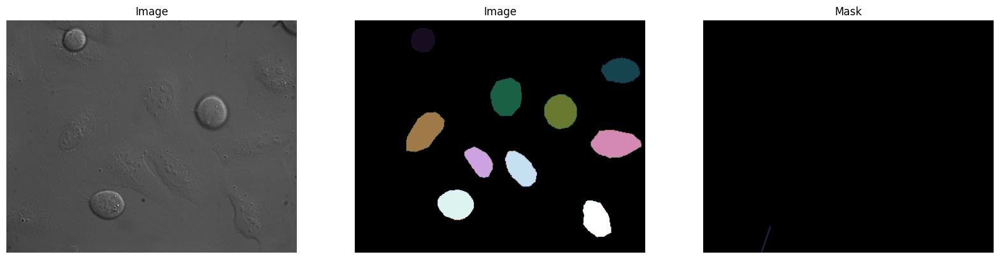

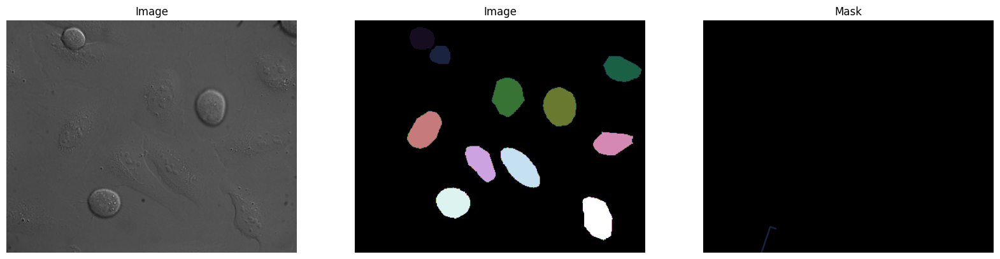

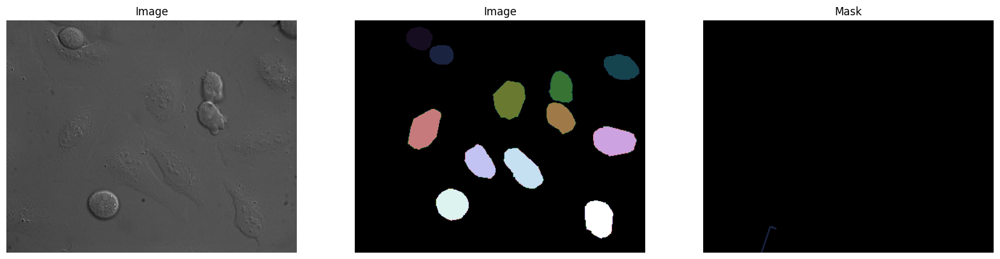

...

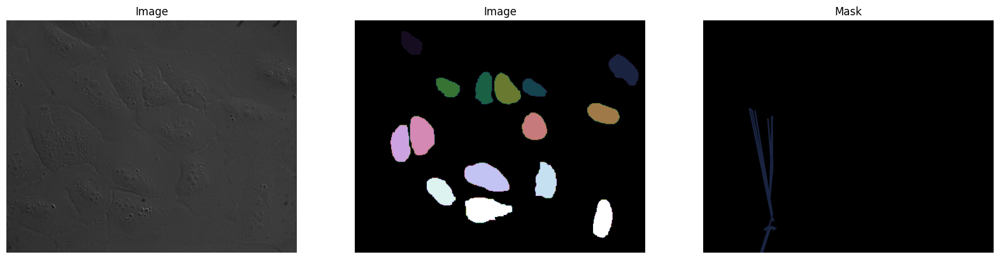

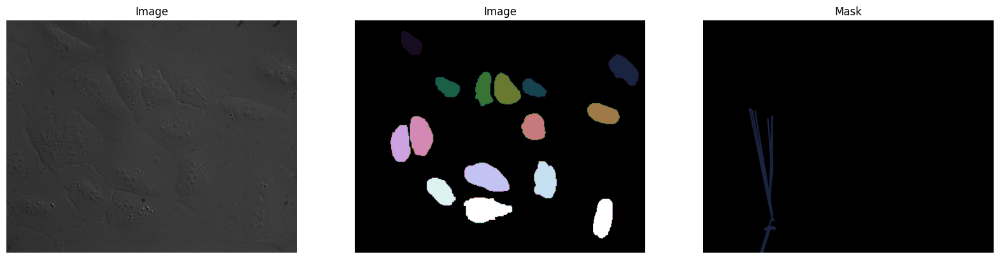

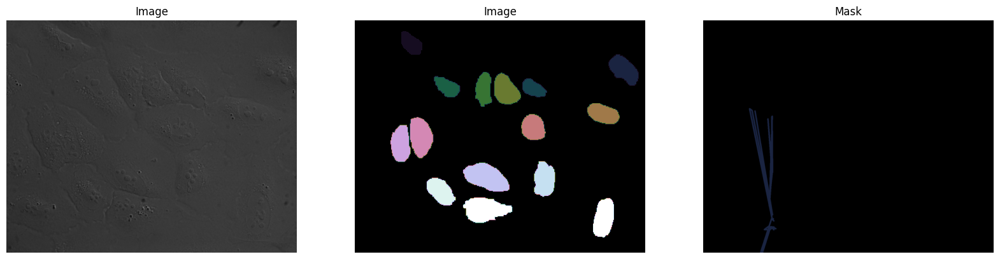

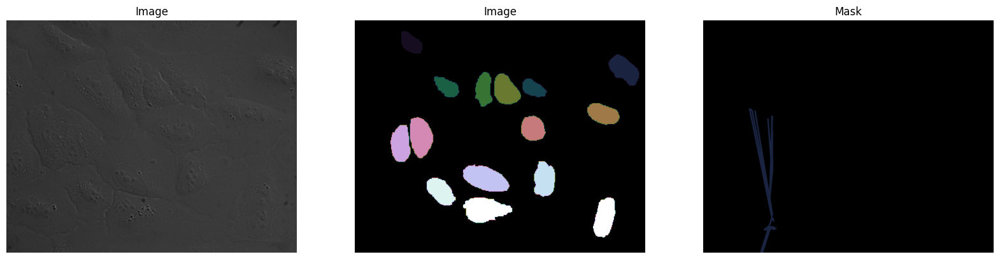

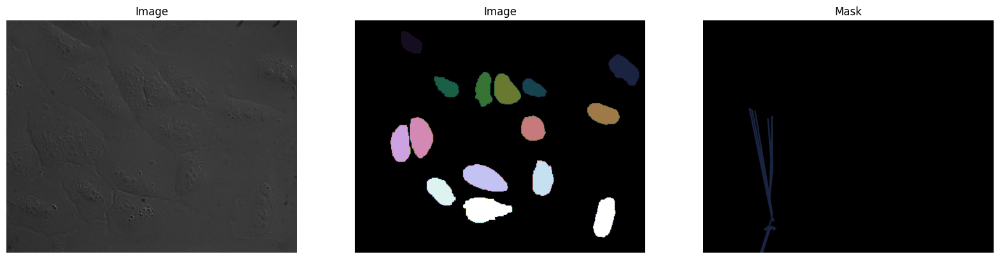

IndexError: list index out of range

In [250]:
track_images = []
track_image = np.zeros(images[0].shape)
height = track_image.shape[0]
width = track_image.shape[1]
for i in range(len(images)-1):
    for track_id, track in tracks.items():
        if track_id == 2:
            rgba = cubehelix(track_id)
            thickness = 5
            # track_image = cv2.circle(track_image, track[i], 63, rgba, -1)
            track_image = cv2.line(track_image,  track[i], track[i+1], rgba, thickness)
    fig, ax = plt.subplots(1, 3, figsize=(20,15))
    ax[0].imshow(images[i], cmap=cubehelix)
    ax[0].set_title("Image")
    ax[0].axis('off')
    ax[1].imshow(watershed_video_labels[i], cmap=cubehelix)
    ax[1].set_title("Image")
    ax[1].axis('off')
    ax[2].imshow(track_image, cmap='grey')
    ax[2].set_title("Mask")
    ax[2].axis('off')
    plt.show()
    